<a href="https://colab.research.google.com/github/EllieMwangi/House-price-prediction/blob/master/House_Prices_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Data Exploration

In [2]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split as tts
import statsmodels.formula.api as smf
from sklearn.linear_model import LinearRegression

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [3]:
import warnings
warnings.filterwarnings(action='ignore')

In [4]:
%matplotlib inline
sns.set()
plt.rcParams['figure.figsize'] = (12.0, 10.0)

In [5]:
# Install and load pandas profiler
!pip install pandas-profiling==2.6.0

     |████████████████████████████████| 245kB 2.7MB/s 
     |████████████████████████████████| 71kB 4.8MB/s 
     |████████████████████████████████| 71kB 4.7MB/s 
     |████████████████████████████████| 81kB 4.9MB/s 
     |████████████████████████████████| 604kB 8.5MB/s 
     |████████████████████████████████| 3.1MB 13.7MB/s 
     |████████████████████████████████| 9.5MB 19.7MB/s 
     |████████████████████████████████| 296kB 34.7MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=f597b848414b726b44fceee0acfa8be2882a925c44a347866c13404522e64f9a
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for imagehash: filename=ImageHash-4.1.0-py2.py3-none-any.whl size=291991 sha256=c76a9d62ad822483b0ced9ce30a1067d0e54ef00d41385a4030a353f4ddbcad1
  Stored in directory: /root/.cache/pip/wheels/07/1c/dc/6831446f09feb8cc199ec73a0f2f0703253f6ae013a22f4be9
Successfully built htmlmin imag

In [6]:
from pandas_profiling import ProfileReport

In [7]:
# Load dataset
house_data = pd.read_csv('house_data.csv')

In [8]:
#Preview data
house_data.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [9]:
# Sample 5 records
house_data.sample(5)

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
14882,8679400130,353000.0,4,1.50,1100,9600,1.0,0,0,4,6,1100,0,1960,0,98033,47.7000,-122.175,1100,9630
11170,9424400105,525000.0,4,1.75,2280,5959,1.0,0,0,3,7,1250,1030,1947,0,98116,47.5655,-122.395,1640,5911
4004,4178500100,282500.0,3,2.25,1670,7150,2.0,0,0,4,7,1670,0,1990,0,98042,47.3603,-122.088,1570,7040
21101,7242800020,277140.0,3,1.50,1190,785,2.0,0,0,3,8,920,270,2014,0,98052,47.6781,-122.117,2820,5626
17627,1074100110,355300.0,3,2.50,1620,7410,1.0,0,0,5,7,1620,0,1955,0,98133,47.7708,-122.335,1450,8121


In [10]:
# Check shape of data
house_data.shape

(21613, 20)

In [11]:
# Describe data
house_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   price          21613 non-null  float64
 2   bedrooms       21613 non-null  int64  
 3   bathrooms      21613 non-null  float64
 4   sqft_living    21613 non-null  int64  
 5   sqft_lot       21613 non-null  int64  
 6   floors         21613 non-null  float64
 7   waterfront     21613 non-null  int64  
 8   view           21613 non-null  int64  
 9   condition      21613 non-null  int64  
 10  grade          21613 non-null  int64  
 11  sqft_above     21613 non-null  int64  
 12  sqft_basement  21613 non-null  int64  
 13  yr_built       21613 non-null  int64  
 14  yr_renovated   21613 non-null  int64  
 15  zipcode        21613 non-null  int64  
 16  lat            21613 non-null  float64
 17  long           21613 non-null  float64
 18  sqft_l

No null values in data.

In [12]:
# Check for duplicates
house_data.duplicated().sum()

3

In [13]:
# Get rid of duplicate records
house_data.drop_duplicates(inplace=True)

### Data Analysis

In [14]:
# Generate profile report for housing data
data_profile = ProfileReport(house_data.drop('id', axis=1))
data_profile

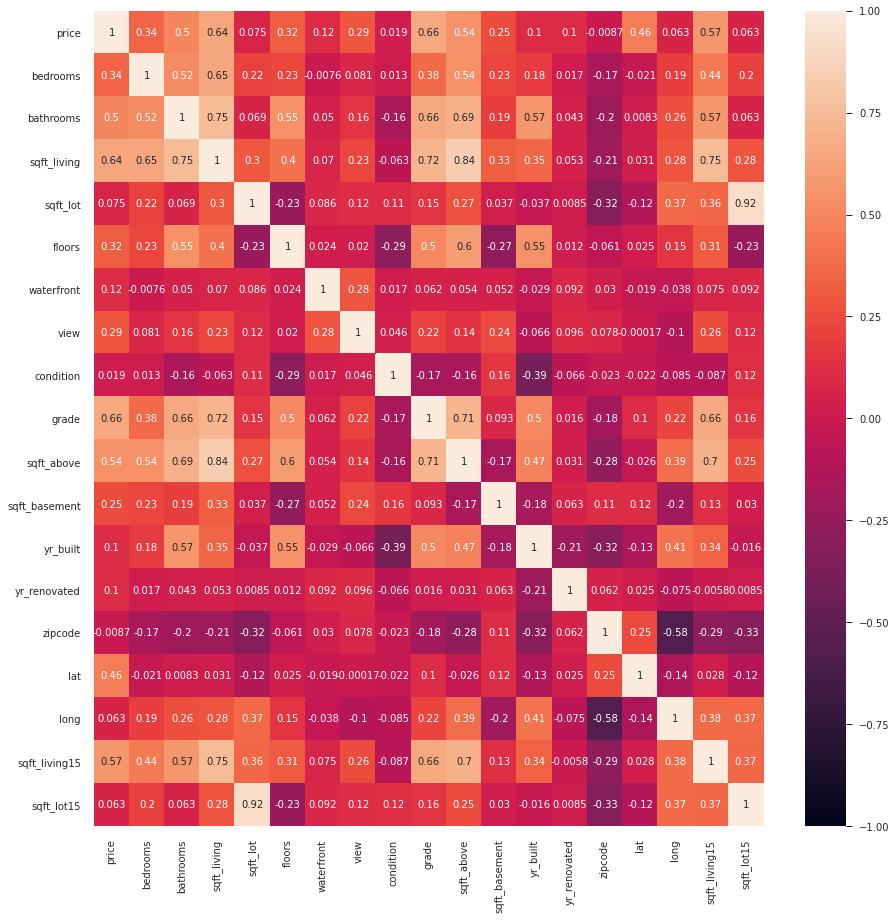

In [15]:
# plot a correlation matrix
spearman_corr = house_data.drop('id', axis=1).corr(method='spearman')
plt.figure(figsize=(15,15))
sns.heatmap(spearman_corr, vmin=-1, vmax=1, annot=True)

Based on the correlation matrix, the following features have the highest correlation with Price target variable:
- sqft_living
- grade
- sqft_above
- sqft_living15
- bathrooms


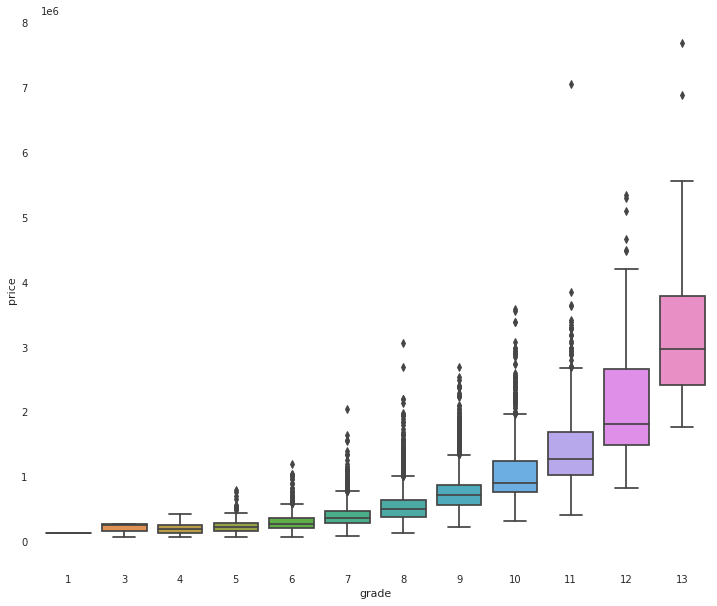

In [16]:
# Investigate relation between house price and grade
plt.figure(figsize=(12,10))
sns.boxplot(x=house_data['grade'], y=house_data['price'])

Houses of higher grades have higher prices.

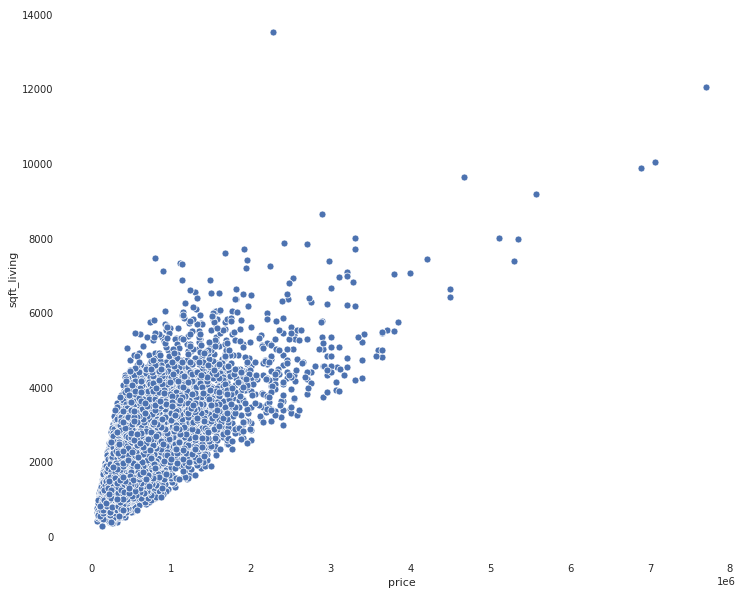

In [17]:
# Investigate relation between house price and sqft_living
plt.figure(figsize=(12,10))
sns.scatterplot(house_data['price'], house_data['sqft_living'])

Houses with a larger living space tend to have a higher price.

'Correlation: '

0.7564195702606058

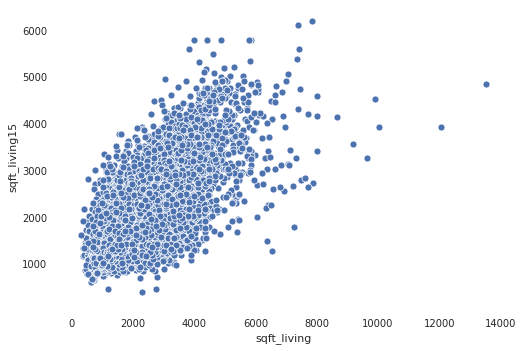

In [18]:
# Investigate relationship between sqft_living and sqft_living15
display("Correlation: ", house_data['sqft_living'].corr(house_data['sqft_living15']))
sns.scatterplot(house_data['sqft_living'], house_data['sqft_living15'])

High correlation between sqft_living and sqft_living15

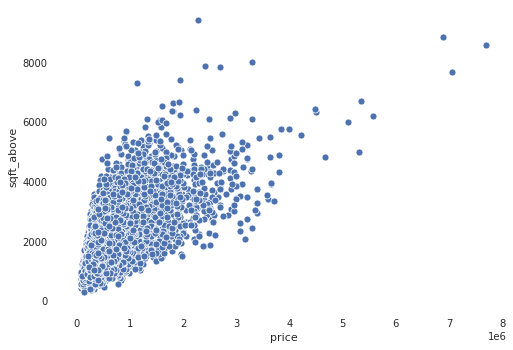

In [19]:
# Investigate relation between house price and sqft_living
sns.scatterplot(house_data['price'], house_data['sqft_above'])

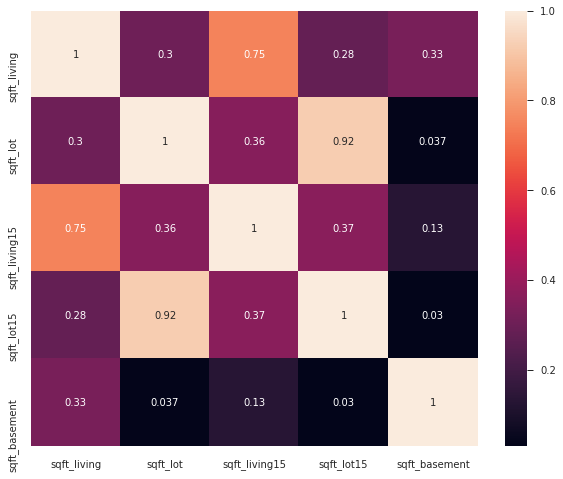

In [20]:
# Check correlation between square footage features
footage_features = ['sqft_living', 'sqft_lot','sqft_living15', 'sqft_lot15','sqft_basement']
plt.figure(figsize=(10,8))
sns.heatmap(house_data[footage_features].corr(method='spearman'), annot=True)


High correlation between sqft_lot and sqft_lot15 as well as between sqft_living and sqft_living15

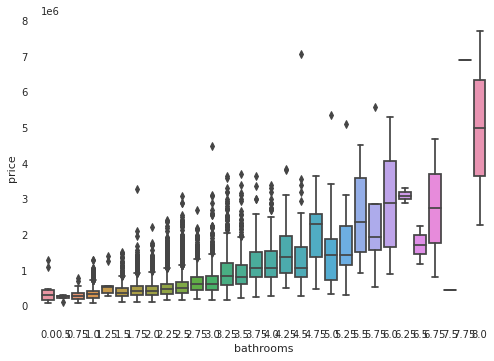

In [21]:
# Investigate relationship between price and bathrooms
sns.boxplot(x=house_data['bathrooms'], y=house_data['price'])

There is a discernable increase in price as the number of bathrooms increases

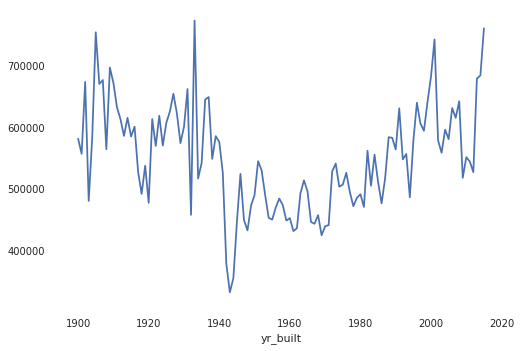

In [22]:
# Get the average price of houses per year
house_data.groupby('yr_built')['price'].mean().plot()

Houses built between 1940 and 1950 have the lowest average price

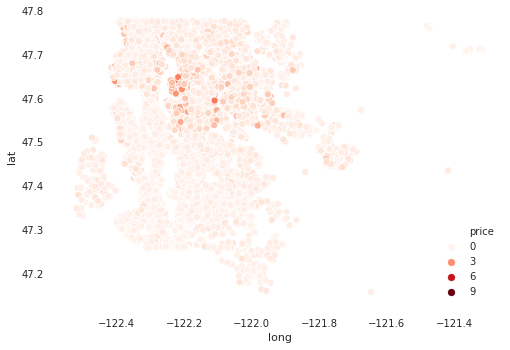

In [23]:
sns.scatterplot(house_data['long'], house_data['lat'], hue=house_data['price'], palette='Reds')

Through a simple visualization , it is observable that high priced houses seem to be concentrated in the upper region of the map. 

#### Cluster Analysis of Location Data

In [24]:
from sklearn.cluster import KMeans
location_data = house_data[['long','lat']].to_numpy()

In [25]:
# Perform kmeans clustering with 7 clusters
kmeans = KMeans(n_clusters=7)
kmeans.fit(location_data)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=7, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

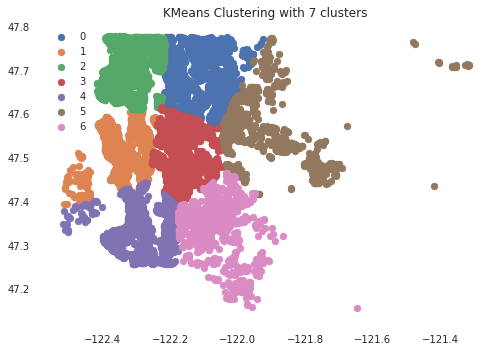

In [26]:
# Get the kmeans scatter plot
predictions = kmeans.labels_
clusters = np.unique(kmeans.labels_)

for clust in clusters:
  row_ix = np.where(predictions == clust)
  plt.scatter(location_data[row_ix, 0], location_data[row_ix, 1], label=clust)

plt.title('KMeans Clustering with 7 clusters')
plt.legend()
plt.show()

In [27]:
# Select appropriate number of clusters with elbow method
SSE = []
for k in  __builtin__.range(1, 15):
  kmeans = KMeans(n_clusters=k, random_state=42)
  kmeans.fit(location_data)
  SSE.append(kmeans.inertia_)

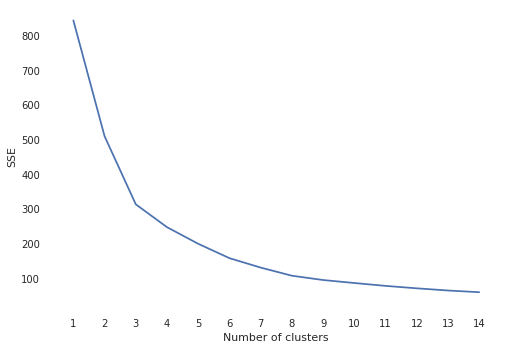

In [28]:
plt.plot(__builtin__.range(1, 15), SSE)
plt.xticks(__builtin__.range(1,15))
plt.xlabel('Number of clusters')
plt.ylabel('SSE')
plt.show()

In [29]:
# Determine appropriate number of clusters using Knee locator
!pip install kneed
from kneed import KneeLocator

In [30]:
appropriate_k = KneeLocator(__builtin__.range(1,15), SSE, curve='convex', direction='decreasing')
appropriate_k.elbow

4

According to the knee locator, the appropriate number of clusters is 4, however 4  clusters will coalesce the region data into 4 big regions that might takeaway some of the nuance of the region specific house pricing.

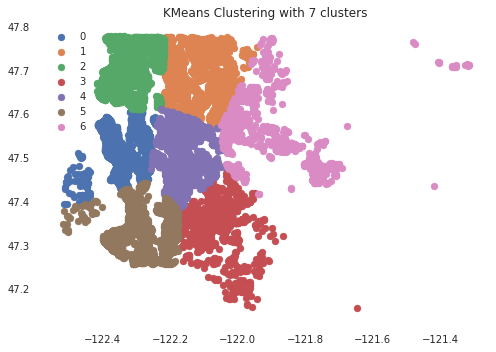

In [31]:
# Perform kmeans clustering with 7 clusters
kmeans = KMeans(n_clusters=7)
kmeans.fit(location_data)

# Get the kmeans scatter plot
predictions = kmeans.labels_
clusters = np.unique(kmeans.labels_)

for clust in clusters:
  row_ix = np.where(predictions == clust)
  plt.scatter(location_data[row_ix, 0], location_data[row_ix, 1], label=clust)

plt.title('KMeans Clustering with 7 clusters')
plt.legend()
plt.show()

In [32]:
# Create region column based on the cluster labels
labels = kmeans.labels_
house_data['region'] = labels

In [33]:
# Get the average house price per region
house_data.groupby('region')['price'].mean().sort_values(ascending=False)

region
1    693347.409438
2    631765.053043
6    579217.762949
4    578243.564496
0    442372.149889
3    346686.067222
5    292061.339835
Name: price, dtype: float64

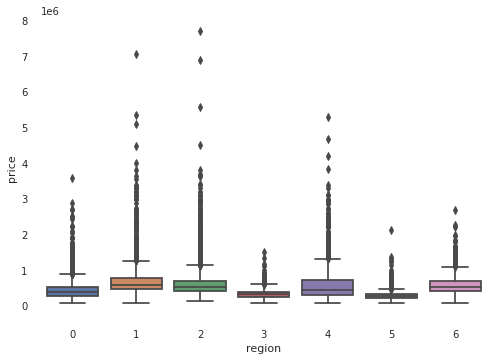

In [34]:
# Investigate relationship between region and house price
sns.boxplot(house_data['region'], house_data['price'])

Regions 2 and 3, have considerably lower house prices

In [35]:
# Investigate correlation
house_data[['price','region']].corr(method='spearman')

,price,region
price,1.00000,-0.15183
region,-0.15183,1.00000


#### Renovation Feature

In [36]:
house_data.groupby(['yr_renovated'])['yr_renovated'].count()/house_data.shape[0]

yr_renovated
0       0.957751
1934    0.000046
1940    0.000093
1944    0.000046
1945    0.000139
          ...   
2011    0.000602
2012    0.000509
2013    0.001712
2014    0.004211
2015    0.000740
Name: yr_renovated, Length: 70, dtype: float64

A large percentage of houses (95%) have 0 as their renovation year, taking the assumption that 0 means that the house has not been renovated, a binary feature indicating if a house has been renovated or not, is more suitable

In [37]:
house_data['renovated'] = np.where(house_data['yr_renovated'] == 0, 0,1)

In [38]:
house_data.groupby('renovated')['price'].mean()

renovated
0    530444.136590
1    760859.477547
Name: price, dtype: float64

Renovated houses have a higher average price despite being considerably fewer than houses that have not been renovated.

In [39]:
# bin year built variable
bins = [1900, 1905, 1910, 1915, 1920, 1925, 1930, 1935, 1940, 1945, 1950, 1955, 1960, 1965, 1970, 1975, 1980, 1985, 1990, 1995, 2000, 2005, 2010, 2015]
house_data['yr_built_binned'] = np.searchsorted(bins, house_data['yr_built'].values)
house_data[['yr_built', 'yr_built_binned']].head(10)

,yr_built,yr_built_binned
0,1955,11
1,1951,11
2,1933,7
3,1965,13
4,1987,18
5,2001,21
6,1995,19
7,1963,13
8,1960,12
9,2003,21


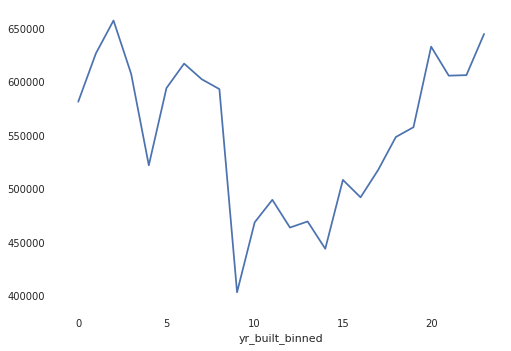

In [40]:
house_data.groupby(['yr_built_binned'])['price'].mean().plot()

In [41]:
house_data[['yr_built_binned','price']].corr(method='spearman')

,yr_built_binned,price
yr_built_binned,1.000000,0.103307
price,0.103307,1.000000


Minimal correlation between year built and the price variable.

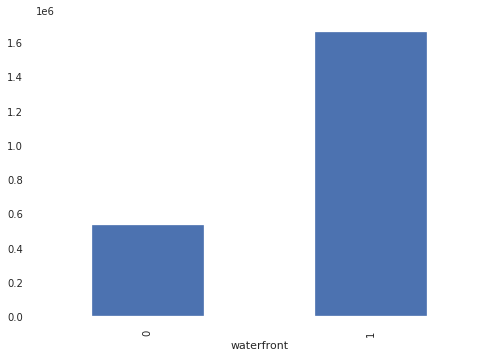

In [42]:
house_data.groupby('waterfront')['price'].mean().plot(kind='bar')

Houses with overlooking a waterfront have a higher average price

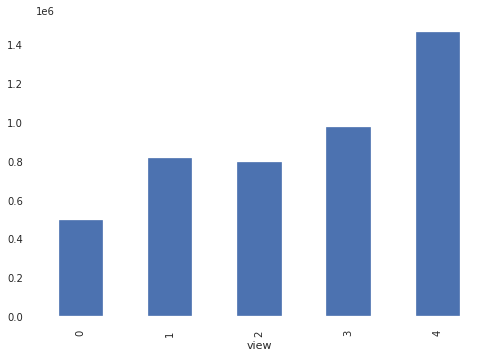

In [43]:
house_data.groupby('view')['price'].mean().plot(kind='bar')

Average house price increases as the view index also increases.

In [44]:
house_data.groupby(['condition'])['price'].mean().sort_values(ascending=False)

condition
5    612577.742504
3    542093.108133
4    521295.650757
1    334431.666667
2    327316.215116
Name: price, dtype: float64

Houses with the highest condition index 5 have the highest average price.

In [45]:
'''
The sqft_living feature is sum of sqft_above and sqft_basement for all records. 
This means that sqft_above and sqft_basement are doing the same thing as sqft_living 
Elastic Net Regression/Lasso regression would set one to zero.
'''
(house_data['sqft_above'] + house_data['sqft_basement'] == house_data['sqft_living']).value_counts()

True    21610
dtype: int64

4.021467451317612

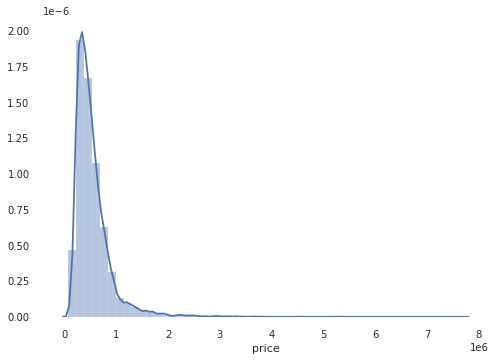

In [46]:
# Investigate target variable
sns.distplot(house_data['price'])
house_data['price'].skew()

The price variable is heavily skewed to the right, with a skew of 4.02

In [47]:
# Create modelling dataset with useful features
to_drop = ['id', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long']
model_data = house_data.drop(to_drop, axis=1)

#### Test for Multicollinearity

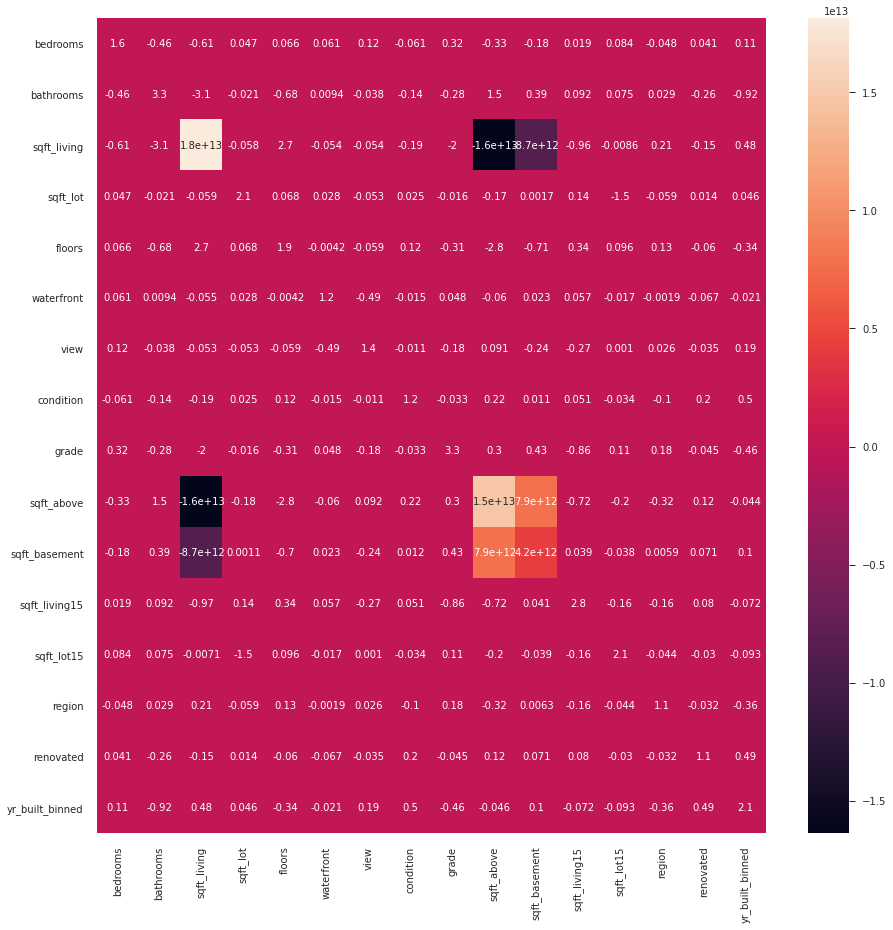

In [48]:
# Check the variance inflation factor
corr_matrix = model_data.drop('price', axis=1).corr()
vif = pd.DataFrame(np.linalg.inv(corr_matrix), index=corr_matrix.index, columns=corr_matrix.columns)
plt.figure(figsize=(15,15))
sns.heatmap(vif, annot=True)

As expected, sqft_living, sqft_above and sqft_basement have extremely high variance factors, to mitigate this, drop the sqft_above and sqft_basement features.

In [49]:
model_data.drop(['sqft_above','sqft_basement'], axis=1, inplace=True)

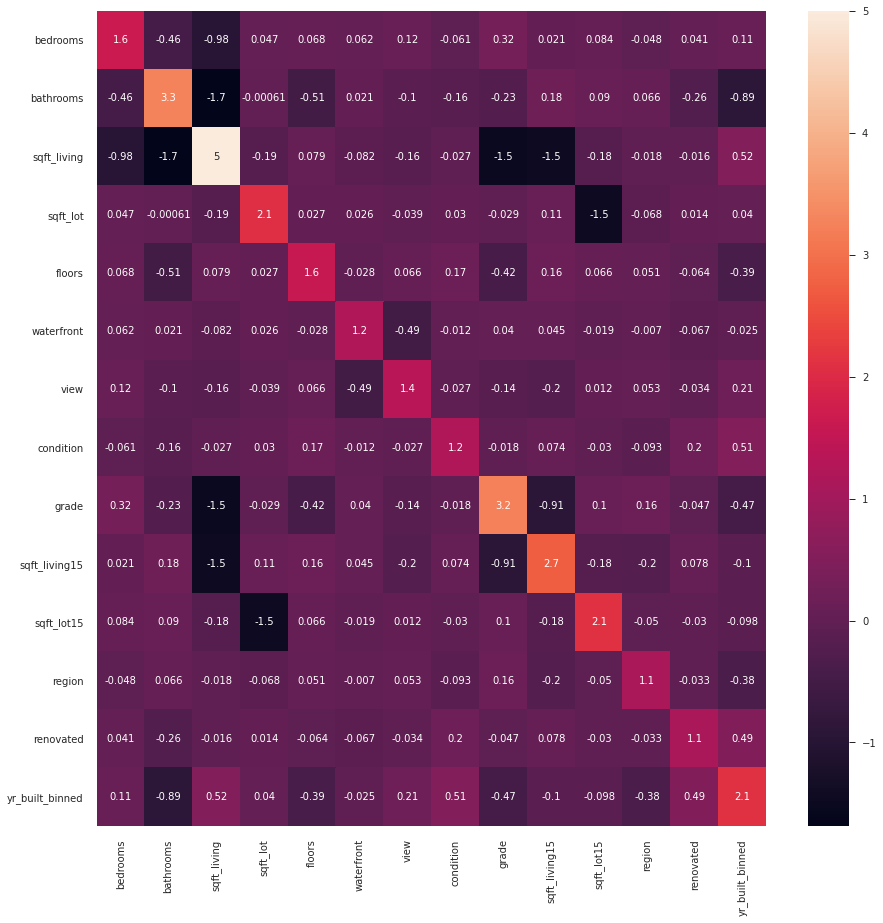

In [50]:
# Check the variance inflation factor
corr_matrix = model_data.drop('price', axis=1).corr()
vif = pd.DataFrame(np.linalg.inv(corr_matrix), index=corr_matrix.index, columns=corr_matrix.columns)
plt.figure(figsize=(15,15))
sns.heatmap(vif, annot=True)

sqft_living has a variance inflation factor of 5 which is cause for potential concern, however due to the feature's correlation with the target variable, it is retained.

### Multiple Linear Regression

In [51]:
from sklearn.metrics import mean_squared_error
from scipy.stats import bartlett, chi2

In [52]:
dummy_var = ['waterfront','view','renovated']
X = house_data.drop('price', axis=1)
Y = house_data['price']

# Split data
x_train, x_test, y_train, y_test = tts(X, Y, test_size=.3, random_state=24)

In [53]:
#Scale features
scaler = RobustScaler().fit(x_train.drop(dummy_var, axis=1))
num_train = scaler.transform(x_train.drop(dummy_var, axis=1))
x_train = np.concatenate((num_train, x_train[dummy_var].to_numpy()), axis=1)

num_test = scaler.transform(x_test.drop(dummy_var, axis=1))
x_test = np.concatenate((num_test, x_test[dummy_var].to_numpy()), axis=1)

In [54]:
#Linear regression

linreg = LinearRegression()
linreg.fit(x_train, y_train)
linpred = linreg.predict(x_test)

residuals = np.subtract(linpred, y_test)
print('RMSE: ', np.sqrt(mean_squared_error(y_test,linpred)))
print('R2: ', linreg.score(x_test, y_test))

RMSE:  197735.82498935476
R2:  0.688272231193654


In [56]:
#print out coefficients for each features
col_names = X.drop(dummy_var,axis=1).columns.to_list()
col_names.extend(dummy_var)
coefficients = dict(zip(col_names, linreg.coef_))

sort_coefficients = sorted(coefficients.items(), key=lambda x: x[1])

for i in sort_coefficients:
	print(i[0], i[1])

renovated -7275760.529533824
yr_built -99358.49679428879
zipcode -51627.56183210991
bedrooms -40220.79511988795
long -35402.58814864425
region -19994.72909448108
yr_built_binned -19543.88592043786
id -7425.787705846327
sqft_lot15 -1932.5164621768142
sqft_lot 609.6029433881158
yr_renovated 3665.5367249206715
floors 10124.256253267773
sqft_living15 19141.560206227863
condition 28516.793342601624
sqft_basement 37318.08709022008
bathrooms 38356.98288836628
view 52824.28436310243
grade 95254.79033502187
sqft_above 96292.33506753523
sqft_living 106264.8087522818
lat 115370.94931731449
waterfront 648073.2001521466


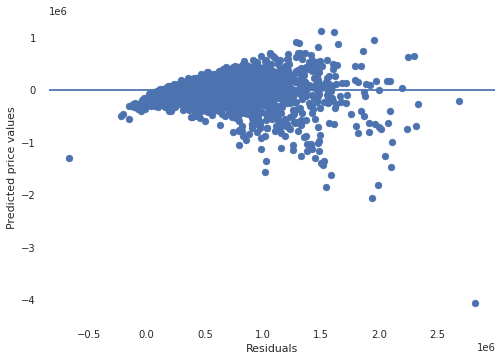

In [57]:
# Create residual plot
plt.scatter(linpred, residuals)
plt.xlabel('Residuals')
plt.ylabel('Predicted price values')
plt.axhline(residuals.mean())

In [58]:
# Perform a bartlett test of variance 
test_result, p_value = bartlett(linpred, residuals)

# Compute a critical value of the chi squared distribution
degree_of_freedom = len(linpred)-1
probability = 1 - p_value

critical_value = chi2.ppf(probability, degree_of_freedom)
print(critical_value, test_result, p_value)

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')

inf 1204.3020201782747 7.085190410901749e-264
the variances are homogeneous!


Despite residuals passing the variance test, the computed critical value is infinite implying the existence of multiple critical points in our data. In accordance to the multicollinearity test a couple of features are correlated which could affect model performance.

### Ridge and Lasso Regression 

For better performance of the model, collinear features had to be removed from the training data, using ridge regression, determine the most suitable features for predicting house prices

In [59]:
from sklearn.linear_model import Ridge, Lasso
from sklearn.model_selection import GridSearchCV

X = house_data.drop(['price','id'], axis=1)
Y = house_data['price']

# Split data
x_train, x_test, y_train, y_test = tts(X, Y, test_size=.3, random_state=24)

In [60]:
#Scale features
scaler = RobustScaler().fit(x_train.drop(dummy_var, axis=1))
num_train = scaler.transform(x_train.drop(dummy_var, axis=1))
x_train = np.concatenate((num_train, x_train[dummy_var].to_numpy()), axis=1)

num_test = scaler.transform(x_test.drop(dummy_var, axis=1))
x_test = np.concatenate((num_test, x_test[dummy_var].to_numpy()), axis=1)

In [61]:
# potential alpha values
alphas = np.logspace(-5,3,10)
ridgereg = Ridge()

In [62]:
grid_ridge = GridSearchCV(ridgereg, param_grid={'alpha':alphas}, scoring='neg_mean_squared_error', cv=10, refit=True)

In [63]:
# best score
grid_ridge.fit(x_train, y_train)
print(grid_ridge.best_params_,  np.sqrt(abs(grid_ridge.best_score_)))

{'alpha': 0.0005994842503189409} 203032.49476648134


There is a drop in model performance in terms of the RMSE.

In [64]:
ridgereg = Ridge(alpha=0.0005994842503189409).fit(x_train,y_train)

In [65]:
#R2 score
ridgereg.score(x_test,y_test)

0.6882579004297761

Ridge regression performance is relatively similar to linear model

In [66]:
#print out coefficients for each features
col_names = X.drop(dummy_var,axis=1).columns.to_list()
col_names.extend(dummy_var)
dict(zip(col_names, ridgereg.coef_))

sort_coefficients = sorted(coefficients.items(), key=lambda x: x[1])

for i in sort_coefficients:
	print(i[0], i[1])

renovated -7275760.529533824
yr_built -99358.49679428879
zipcode -51627.56183210991
bedrooms -40220.79511988795
long -35402.58814864425
region -19994.72909448108
yr_built_binned -19543.88592043786
id -7425.787705846327
sqft_lot15 -1932.5164621768142
sqft_lot 609.6029433881158
yr_renovated 3665.5367249206715
floors 10124.256253267773
sqft_living15 19141.560206227863
condition 28516.793342601624
sqft_basement 37318.08709022008
bathrooms 38356.98288836628
view 52824.28436310243
grade 95254.79033502187
sqft_above 96292.33506753523
sqft_living 106264.8087522818
lat 115370.94931731449
waterfront 648073.2001521466


Coefficients of ridge model and linear model are relatively similar.

In [73]:
lassoreg = Lasso()
parameters = {'alpha': np.concatenate((np.arange(0.1,2,0.1), np.arange(2, 5, 0.5), np.arange(5, 25, 1)))}
grid_lasso = GridSearchCV(lassoreg, parameters, scoring ='r2') 

In [74]:
grid_lasso.fit(x_train, y_train)
print(grid_lasso.best_params_, grid_lasso.best_score_)

{'alpha': 0.1} 0.7021607220000978


In [75]:
# Train Lasso regressor
grid_lasso = Lasso(alpha=0.1)
grid_lasso.fit(x_train, y_train)
print(grid_lasso.score(x_test, y_test))
print( np.sqrt(mean_squared_error(y_test,grid_lasso.predict(x_test))))

0.6875118333905124
197976.84667813848


In [77]:
#print out coefficients for each features
col_names = X.drop(dummy_var,axis=1).columns.to_list()
col_names.extend(dummy_var)
dict(zip(col_names, grid_lasso.coef_))

sort_coefficients = sorted(coefficients.items(), key=lambda x: x[1])

for i in sort_coefficients:
	print(i[0], i[1])

renovated -7275760.529533824
yr_built -99358.49679428879
zipcode -51627.56183210991
bedrooms -40220.79511988795
long -35402.58814864425
region -19994.72909448108
yr_built_binned -19543.88592043786
id -7425.787705846327
sqft_lot15 -1932.5164621768142
sqft_lot 609.6029433881158
yr_renovated 3665.5367249206715
floors 10124.256253267773
sqft_living15 19141.560206227863
condition 28516.793342601624
sqft_basement 37318.08709022008
bathrooms 38356.98288836628
view 52824.28436310243
grade 95254.79033502187
sqft_above 96292.33506753523
sqft_living 106264.8087522818
lat 115370.94931731449
waterfront 648073.2001521466


Lasso coefficients are similar to ridge and multiple linear regression, performance is also pretty similar for all three models. Features that exhibit collinearity still have the same coefficients even with regularization. Perhaps better alpha values would be effective.

#### ElasticNet Regression

In [78]:
from sklearn.linear_model import ElasticNet

In [96]:
# determine x and y
x = house_data.drop(['price','id'], axis=1)
y = house_data['price']

In [97]:
# split into train and test
x_train, x_test, y_train, y_test = tts(x,y,test_size=.2, random_state=42)

In [98]:
# Determine best alpha
elastic=ElasticNet(normalize=True)
grid_elastic = GridSearchCV(estimator=elastic,param_grid={'alpha':np.logspace(-5,2,8),'l1_ratio':[.2,.4,.6,.8]},scoring='r2',n_jobs=1,refit=True,cv=10)

In [99]:
grid_elastic.fit(x_train,y_train)


GridSearchCV(cv=10, error_score=nan,
             estimator=ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True,
                                  l1_ratio=0.5, max_iter=1000, normalize=True,
                                  positive=False, precompute=False,
                                  random_state=None, selection='cyclic',
                                  tol=0.0001, warm_start=False),
             iid='deprecated', n_jobs=1,
             param_grid={'alpha': array([1.e-05, 1.e-04, 1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02]),
                         'l1_ratio': [0.2, 0.4, 0.6, 0.8]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring='r2', verbose=0)

In [100]:
# print best alpha
grid_elastic.best_params_

{'alpha': 1e-05, 'l1_ratio': 0.8}

In [101]:
# best score
grid_elastic.best_score_

0.6970056092090087

In [102]:
elastic_reg = ElasticNet(alpha=1e-05, l1_ratio=0.8).fit(x_train, y_train)
print(f'R2: {elastic_reg.score(x_test, y_test)}')

R2: 0.7060167592250726


Slight improvement in model performance from 0.68 to 0.70

In [103]:
#print out coefficients for each features
col_names = x.columns.to_list()
coefficients = dict(zip(col_names, elastic_reg.coef_))

sort_coefficients = sorted(coefficients.items(), key=lambda x: x[1])

for i in sort_coefficients:
	print(i[0], i[1])

renovated -397716.25007312914
long -181162.62142228612
bedrooms -33349.85868085542
region -6413.702285030395
yr_built -2347.5817537429316
yr_built_binned -1463.024360020346
zipcode -604.3080743279346
sqft_basement -132.3604095358483
sqft_above -104.072617072127
sqft_lot15 -0.39443977719093526
sqft_lot 0.1218730785248872
sqft_living15 27.207903972351566
yr_renovated 219.89903645320803
sqft_living 278.5958559955762
floors 8406.439442100564
condition 27793.709073665075
bathrooms 43653.41625065768
view 54522.009341492514
grade 95937.0890392662
lat 565015.9897381724
waterfront 589742.715874827


Coefficients for collinear features such as sqft_lot, sqft_lot15, sqft_living15, sqft_above have been reduced leading to improved performance.

### Quantile Regression

There is quite a number of features that exhibit multicollinearity within the data, with multiple linear regression these feature had to be removed from our regression model, a more suitable regression to handle this is quantile regression.


In [104]:
from sklearn.preprocessing import MinMaxScaler

In [138]:
model_data = house_data.drop(['zipcode', 'region', 'long','id','yr_built','yr_renovated','sqft_living15','sqft_lot15', 'sqft_above','sqft_basement'], axis=1)
X = model_data.drop('price', axis=1)
Y = model_data['price']

# Split data
x_train, x_test, y_train, y_test = tts(X, Y, test_size=.3, random_state=45)

In [139]:
#Scale features
scaler = MinMaxScaler().fit(x_train)
x_train = scaler.transform(x_train)
x_test = scaler.transform(x_test)

In [140]:
x_frame = pd.DataFrame(x_train, columns=X.columns)
y_frame = pd.DataFrame({'y': y_train})

x_frame.index =  pd.RangeIndex(len(x_frame.index))
y_frame.index = pd.RangeIndex(len(y_frame.index))

data = pd.concat([x_frame, y_frame], axis=1)

In [141]:
data

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,lat,renovated,yr_built_binned,y
0,0.121212,0.31250,0.140578,0.005993,0.0,0.0,0.0,1.00,0.333333,0.683002,0.0,0.652174,544500.0
1,0.060606,0.31250,0.139818,0.002108,0.4,0.0,0.0,0.50,0.555556,0.771632,0.0,0.869565,1430000.0
2,0.121212,0.31250,0.181611,0.002370,0.4,0.0,0.0,0.50,0.555556,0.476791,0.0,0.913043,438800.0
3,0.090909,0.28125,0.089058,0.001866,0.4,0.0,0.0,0.50,0.333333,0.259583,0.0,1.000000,282000.0
4,0.121212,0.28125,0.148936,0.131142,0.0,0.0,0.0,0.75,0.444444,0.219958,0.0,0.739130,404950.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15122,0.151515,0.31250,0.153495,0.002408,0.4,0.0,0.0,0.50,0.333333,0.339479,0.0,0.913043,338000.0
15123,0.060606,0.12500,0.080547,0.004004,0.0,0.0,0.5,0.50,0.333333,0.838590,0.0,0.434783,500000.0
15124,0.060606,0.12500,0.059271,0.004228,0.2,0.0,0.0,0.75,0.333333,0.793466,0.0,0.173913,312000.0
15125,0.121212,0.34375,0.213526,0.004977,0.4,0.0,0.0,0.50,0.555556,0.588226,0.0,0.956522,587000.0


In [142]:
# define quantiles
quantiles = np.arange(0.1, 1.0, 0.1)
mod = smf.quantreg('y ~ bedrooms + bathrooms +	sqft_living	+ sqft_lot +	floors +	waterfront +	view +	condition +	grade	+  lat +	renovated	+ yr_built_binned', data)

for qt in quantiles:
  res = mod.fit(qt)
  print(res.summary())

                         QuantReg Regression Results                          
Dep. Variable:                      y   Pseudo R-squared:               0.3743
Model:                       QuantReg   Bandwidth:                   1.976e+04
Method:                 Least Squares   Sparsity:                    4.331e+05
Date:                Tue, 29 Sep 2020   No. Observations:                15127
Time:                        08:21:58   Df Residuals:                    15114
                                        Df Model:                           12
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
Intercept       -1.967e+05   8353.246    -23.549      0.000   -2.13e+05    -1.8e+05
bedrooms        -3.189e+05   4.64e+04     -6.868      0.000    -4.1e+05   -2.28e+05
bathrooms        1.338e+05    2.1e+04      6.384      0.000    9.27e+04    1.75e+05
sqft_living      1.052e+06 

In [143]:
# get predictions for the .3 percentile
mod_30 = smf.quantreg('y ~ bedrooms + bathrooms +	sqft_living	+ sqft_lot +	floors +	waterfront +	view +	condition +	grade	+  lat +	renovated	+ yr_built_binned', data)
res = mod_30.fit(.3)

parameters_30 = [res.params[x] for x in X.columns]

In [146]:
x_test_30 = pd.DataFrame(x_test, columns=X.columns)
x_test_30.index =  pd.RangeIndex(len(x_test_30.index))

In [147]:
for i, col in enumerate(X.columns.to_list()):
  x_test_30[col] = parameters_30[i] * x_test_30[col] 

In [148]:
x_test_30['y_pred'] = x_test_30.sum(axis=1)

In [149]:
# get the rmse score
np.sqrt(mean_squared_error(y_test, x_test_30['y_pred'].values))

232081.17057430977

The rmse score for the 30th percentile is slightly higher than that of the multiple linear regression as well as that of the ridge and lasso regressors

### Conclusion

The best performing model for our dataset was the elastic net model with an r2 score of 0.70. It best suits our data to the presence of multicollinearity in our features.